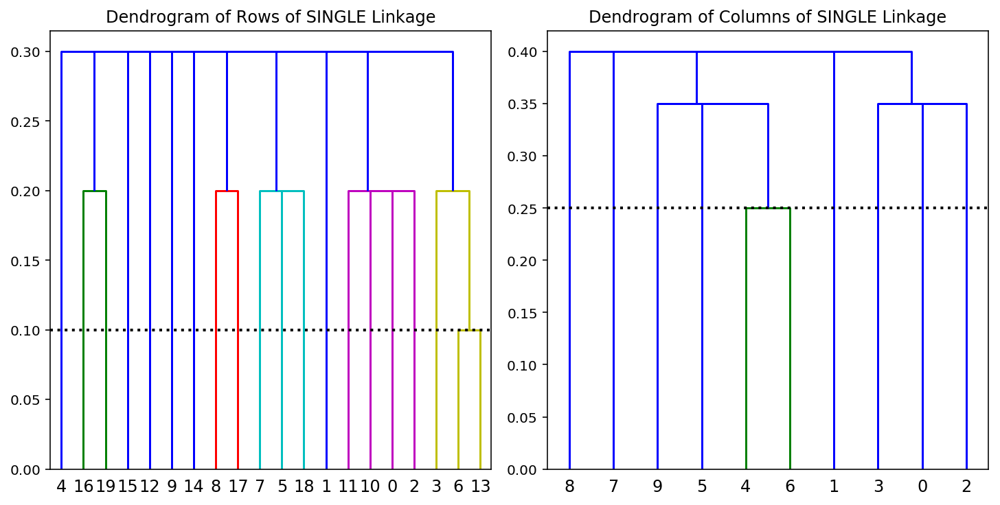

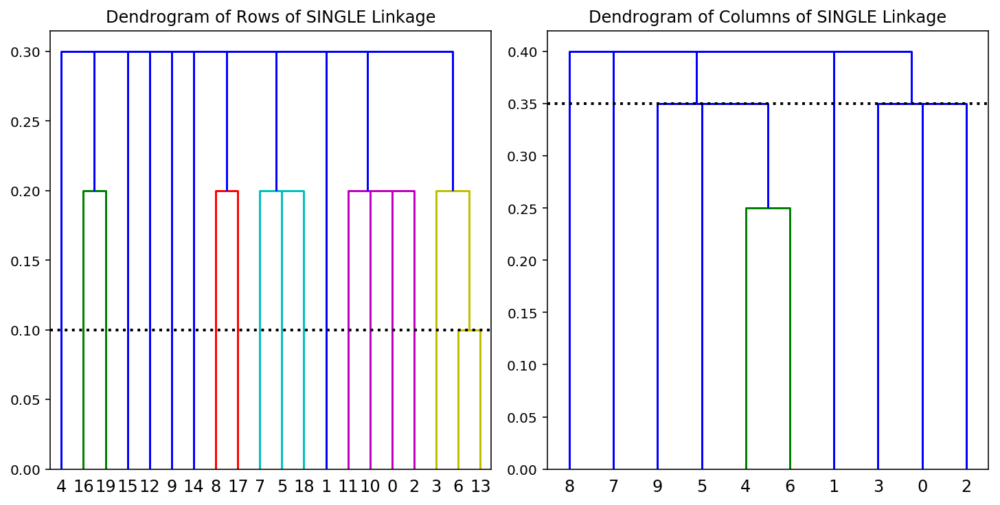

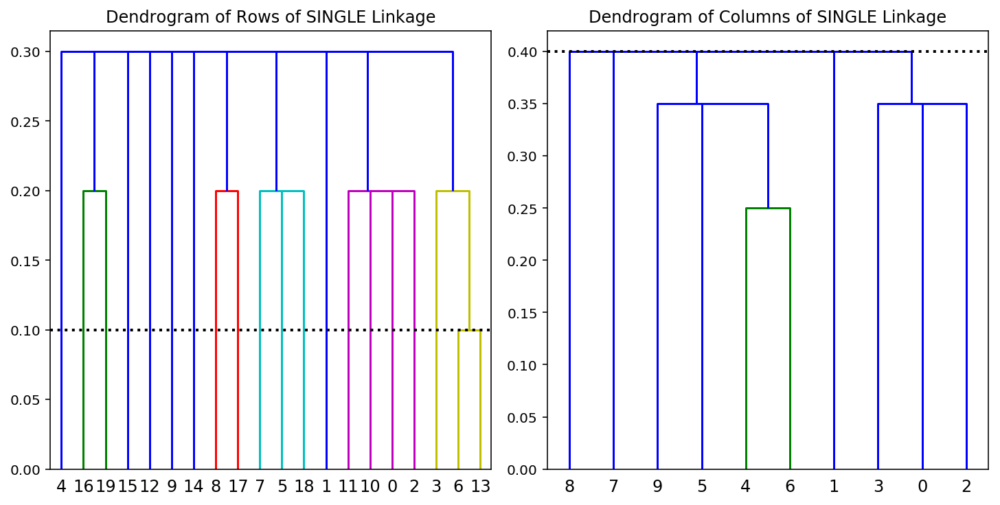

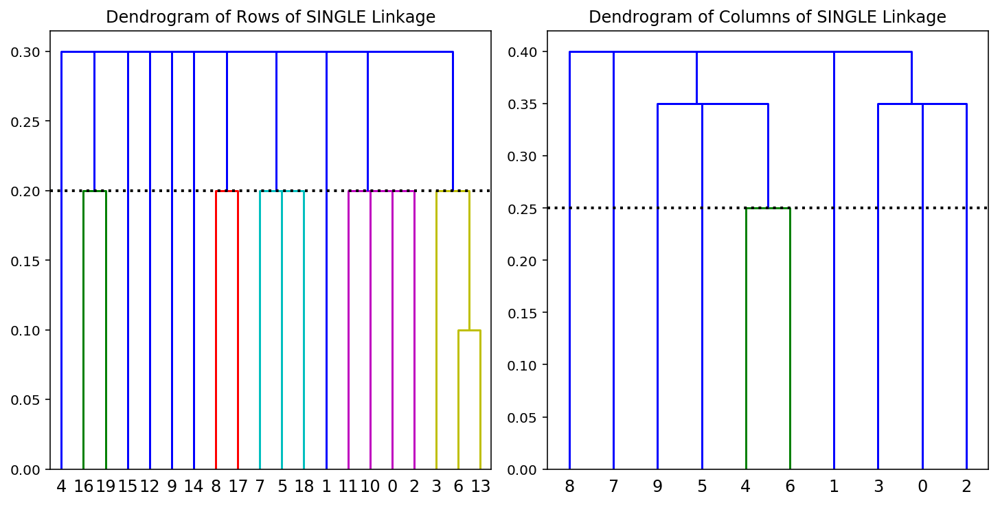

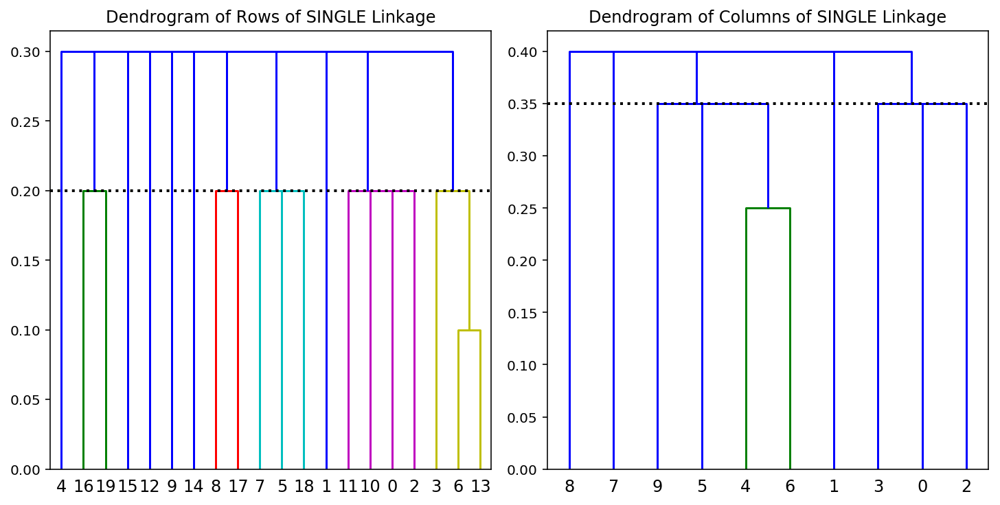

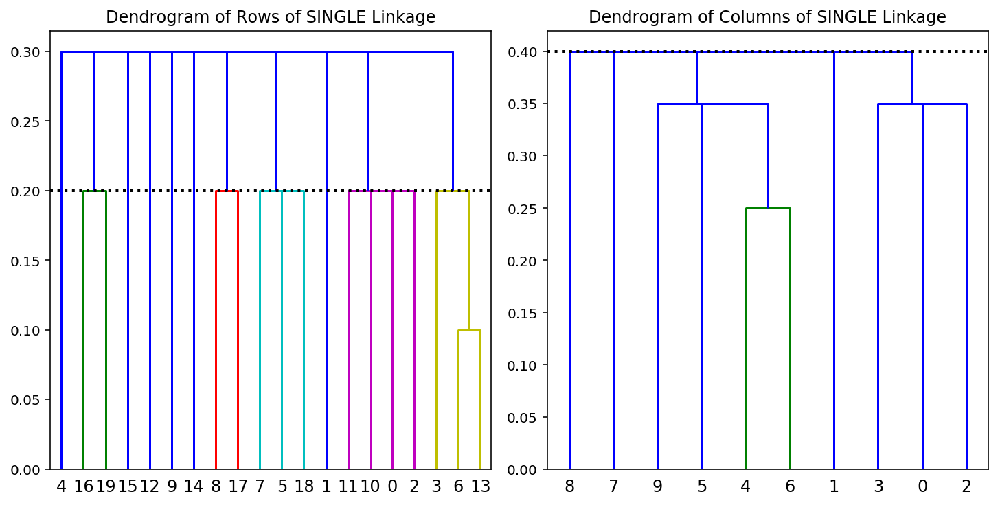

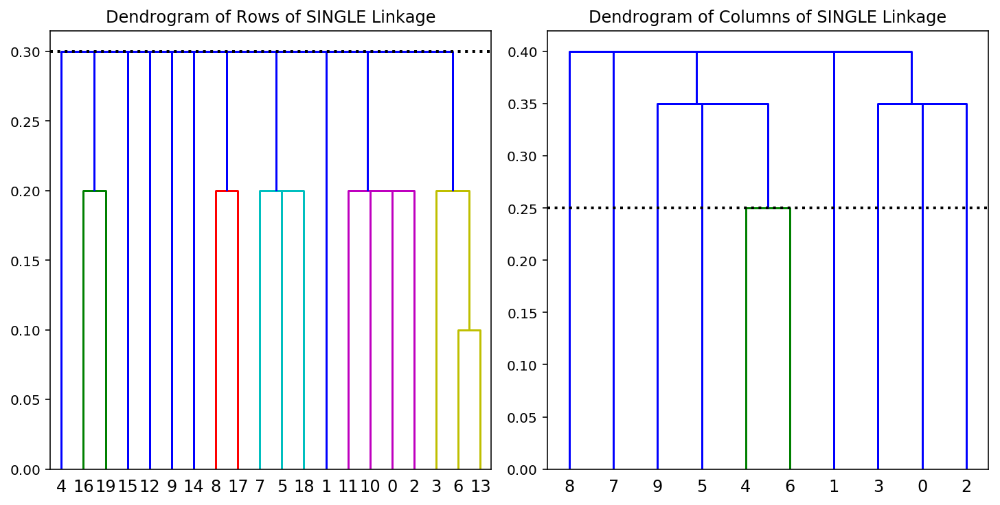

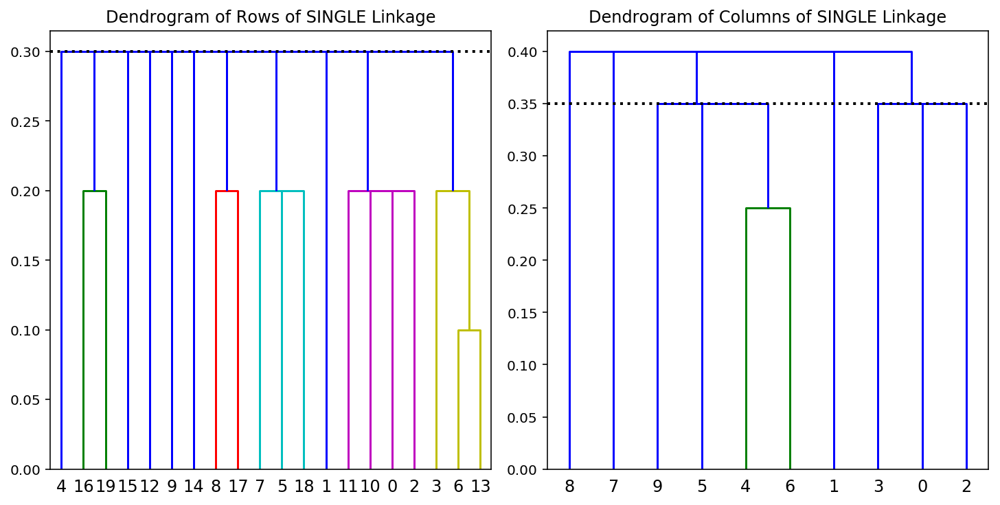

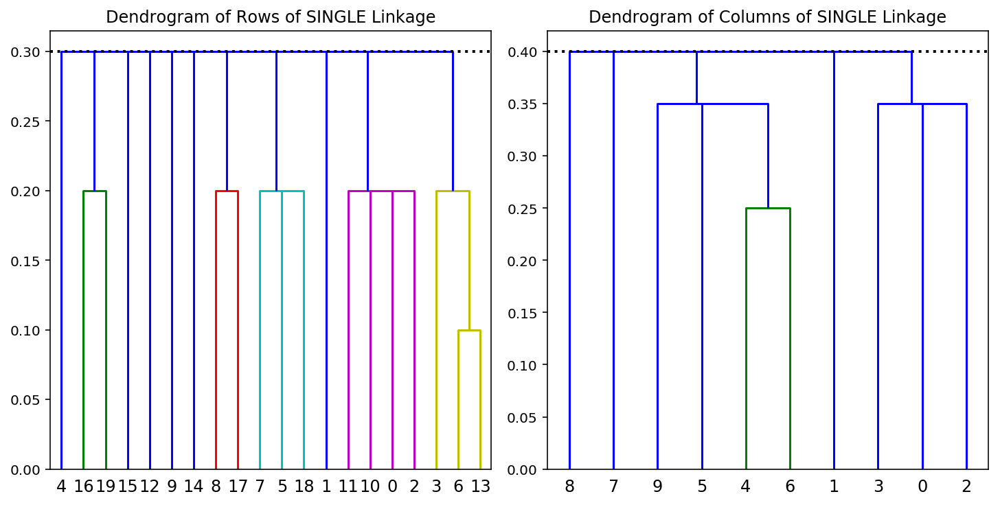

In [13]:
from hierarchyClustering import *
from bokeh.plotting import figure
import numpy as np
import panel as pn
import param
pn.extension()

import panel.widgets as pnw

width0 = 300

df = pd.DataFrame(mat)


methods_button = pnw.RadioButtonGroup(name='methods_button',
                                      value=list(methods.keys())[0],
                                      options=list(methods.keys()),
                                     )
methods_wids = pn.Column('<br>\n## Hierarchy Clustering Methods', methods_button, width = 500)


row_Height = pnw.RadioButtonGroup(name='Rows Dendrogram Height:',
                                  value=['1','2','3'][0],
                                  options=['1','2','3'],)
col_Height = pnw.RadioButtonGroup(name='Columns Dendrogram Height:', 
                                  value=['1','2','3'][0],
                                  options=['1','2','3'],)
hei_wids = pn.Column('\n#### Rows Dendrogram Heights:', row_Height,
                     '\n#### Columns Dendrogram Heights:', col_Height)



pns = []

ms = list(methods.keys())
  
            
method = ms[0]
clus = HierBicluster(mat,method,methods[method])
row_Height.options = [str(round(i,2)) for i in clus.hR]
col_Height.options = [str(round(i,2)) for i in clus.hC]
k=0
for rh in clus.hR:
    row_Height.value = str(round(rh,2))
    for ch in clus.hC:
        col_Height.value = str(round(ch,2))
        fig = plt.figure(constrained_layout=True,figsize=(10,5))
        spec = fig.add_gridspec(1,4)
        ax1 = fig.add_subplot(spec[0:2])
        ax2 = fig.add_subplot(spec[2:])
        if rh:
            ax1.axhline(y=rh,linestyle='dotted',linewidth=2, color='black')
        if ch:
            ax2.axhline(y=ch,linestyle='dotted',linewidth=2, color='black')
        dendrogram(clus.ZR, ax=ax1 )
        ax1.set_title(f'Dendrogram of Rows of {str.upper(clus.method)} Linkage')
        dendrogram(clus.ZC, ax=ax2)
        ax2.set_title(f'Dendrogram of Columns of {str.upper(clus.method)} Linkage')
        
        
        pn0 = pn.Column('<br>\n## Original Matrix:',df, width = width0)
        pn1 = pn.Column(methods_wids,hei_wids,fig,clus.oneRation_ByHeights(rh+0.01,ch+0.01))
        pn2 = pn.Row(pn0,pn1)       
        from bokeh.resources import INLINE
        pn2.save(f'{method}/{k}.html', resources=INLINE)   
        k += 1


/home/haoyu/miniconda3/envs/holoviz-tutorial/lib/python3.7/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


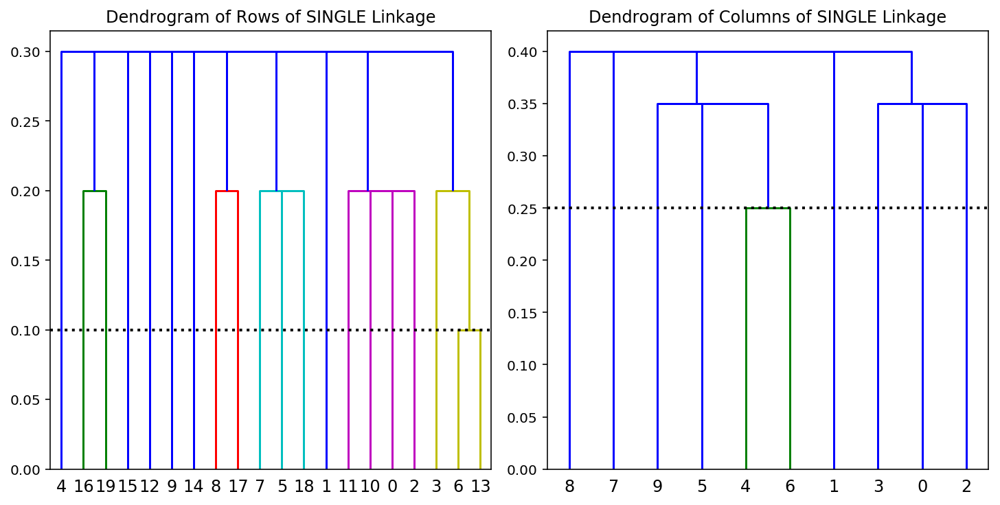

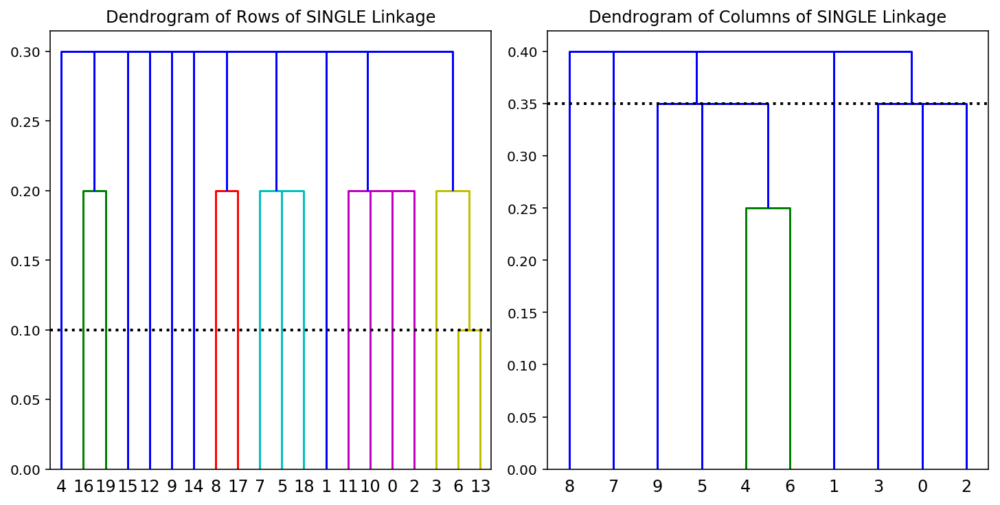

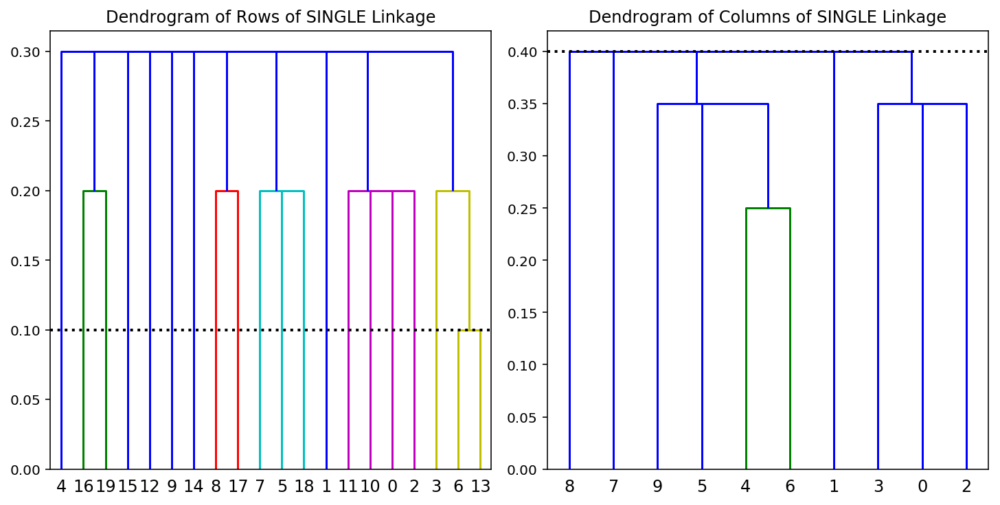

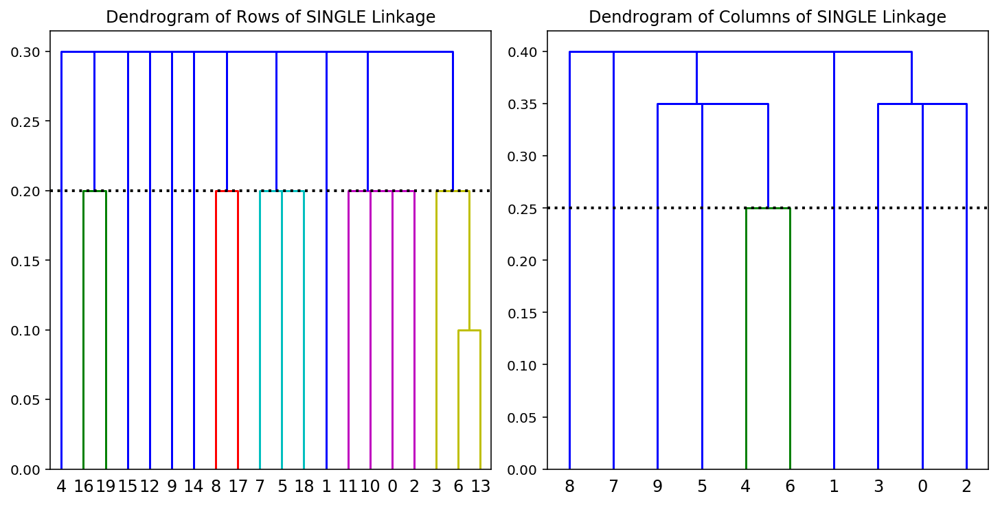

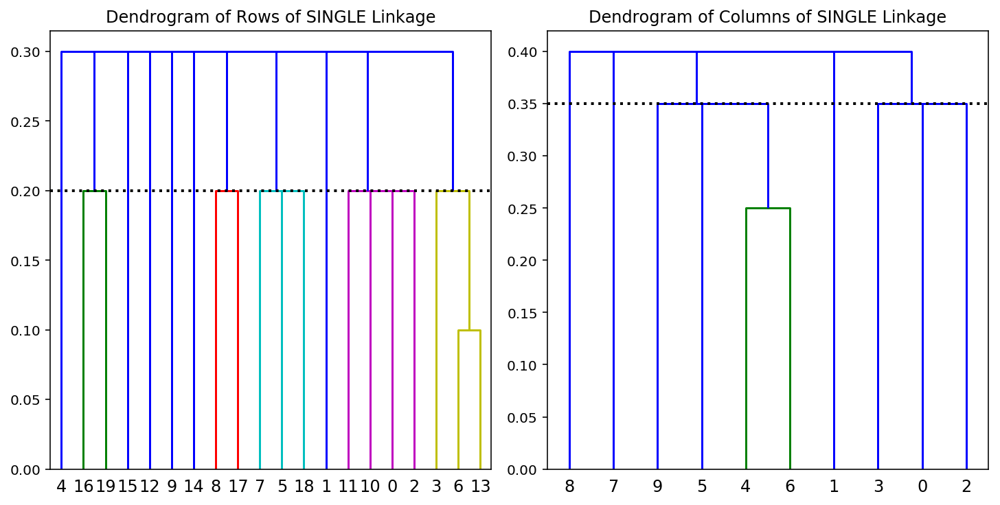

...

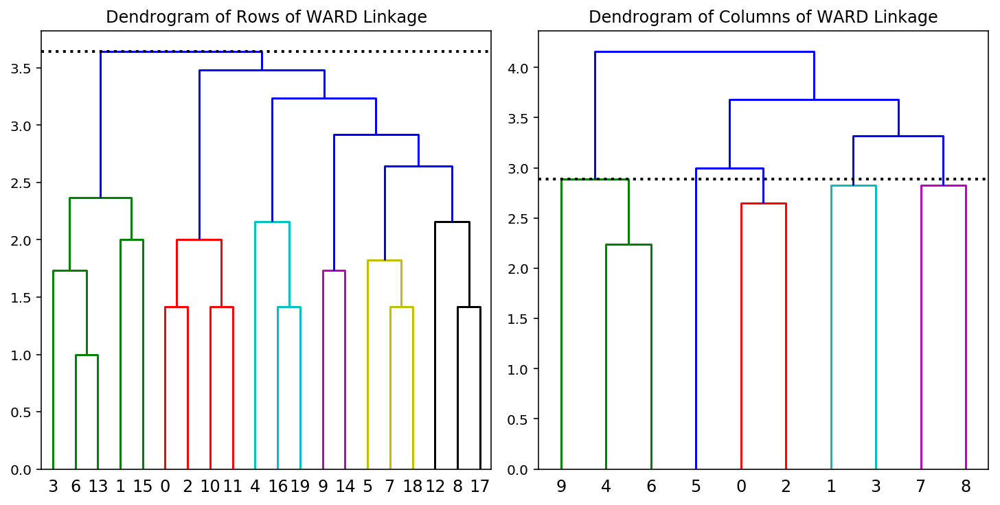

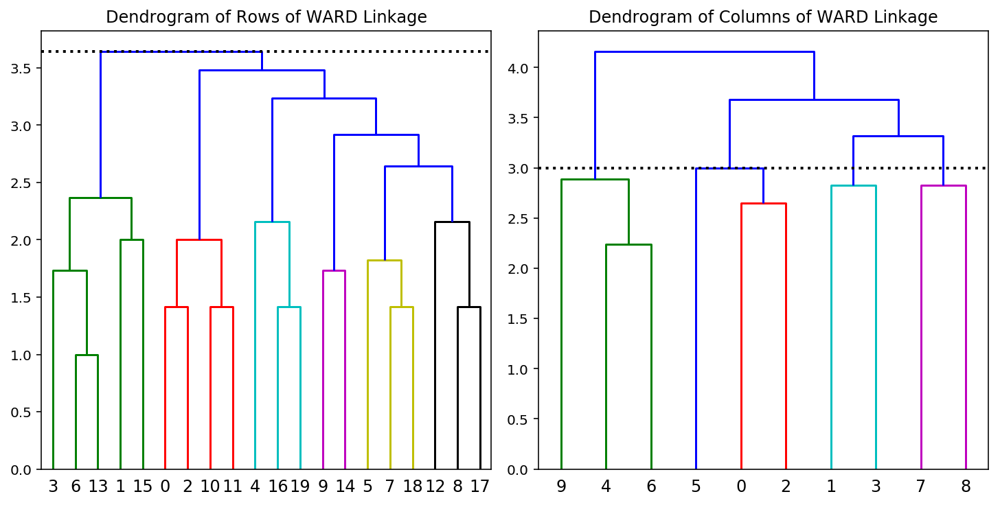

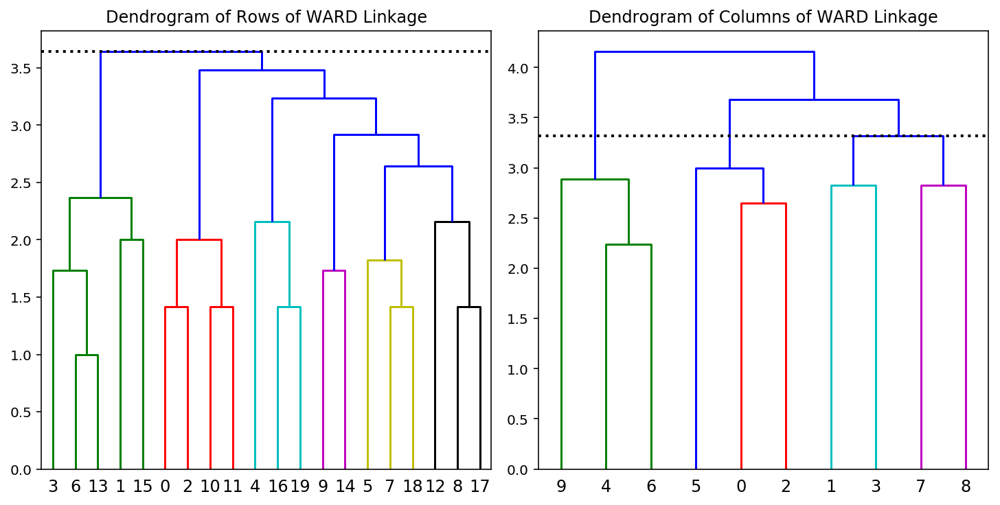

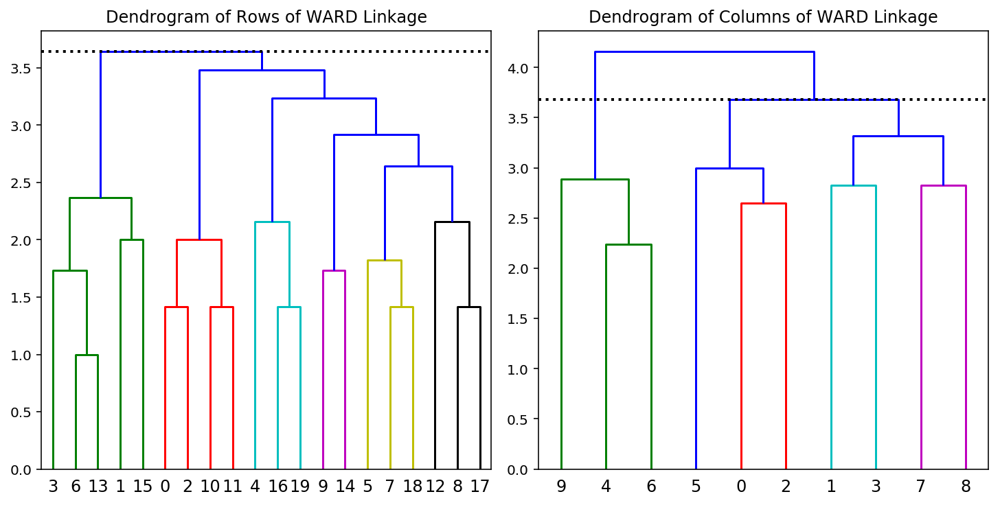

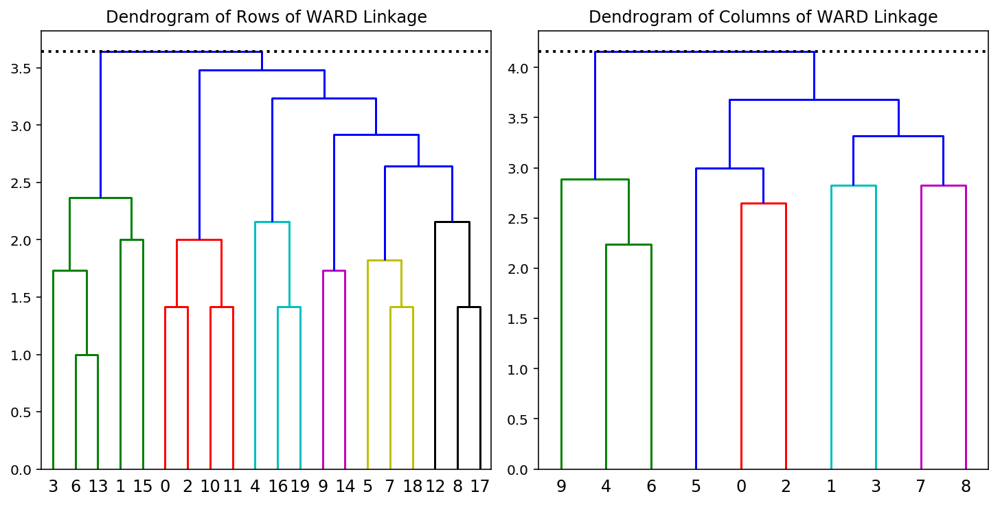

In [14]:
from hierarchyClustering import *
from bokeh.plotting import figure
import numpy as np
import panel as pn
import param
pn.extension()

import panel.widgets as pnw

width0 = 300

df = pd.DataFrame(mat)


methods_button = pnw.RadioButtonGroup(name='methods_button',
                                      value=list(methods.keys())[0],
                                      options=list(methods.keys()),
                                     )
methods_wids = pn.Column('<br>\n## Hierarchy Clustering Methods', methods_button, width = 500)


row_Height = pnw.RadioButtonGroup(name='Rows Dendrogram Height:',
                                  value=['1','2','3'][0],
                                  options=['1','2','3'],)
col_Height = pnw.RadioButtonGroup(name='Columns Dendrogram Height:', 
                                  value=['1','2','3'][0],
                                  options=['1','2','3'],)
hei_wids = pn.Column('\n#### Rows Dendrogram Heights:', row_Height,
                     '\n#### Columns Dendrogram Heights:', col_Height)



pns = []

ms = list(methods.keys())
  
for method in ms:
    if not os.path.exists(method):
        os.makedirs(method)
    methods_button.value = method
    clus = HierBicluster(mat,method,methods[method])
    row_Height.options = [str(round(i,2)) for i in clus.hR]
    col_Height.options = [str(round(i,2)) for i in clus.hC]
    k=0
    for rh in clus.hR:
        row_Height.value = str(round(rh,2))
        for ch in clus.hC:
            col_Height.value = str(round(ch,2))
            fig = plt.figure(constrained_layout=True,figsize=(10,5))
            spec = fig.add_gridspec(1,4)
            ax1 = fig.add_subplot(spec[0:2])
            ax2 = fig.add_subplot(spec[2:])
            if rh:
                ax1.axhline(y=rh,linestyle='dotted',linewidth=2, color='black')
            if ch:
                ax2.axhline(y=ch,linestyle='dotted',linewidth=2, color='black')
            dendrogram(clus.ZR, ax=ax1 )
            ax1.set_title(f'Dendrogram of Rows of {str.upper(clus.method)} Linkage')
            dendrogram(clus.ZC, ax=ax2)
            ax2.set_title(f'Dendrogram of Columns of {str.upper(clus.method)} Linkage')


            pn0 = pn.Column('<br>\n## Original Matrix:',df, width = width0)
            pn1 = pn.Column(methods_wids,hei_wids,fig,clus.oneRation_ByHeights(rh+0.01,ch+0.01))
            pn2 = pn.Row(pn0,pn1)       
            from bokeh.resources import INLINE
            pn2.save(f'{method}/{k}.html', resources=INLINE)   
            k += 1


In [ ]:

# for method in ms:
#     clus = HierBicluster(mat,method,methods[method])
#     row_Height.options = [str(round(i,2)) for i in clus.hR]
#     col_Height.options = [str(round(i,2)) for i in clus.hC]
#     pn2 = pn.Row("---")
#     for rh in clus.hR:
# #         row_Height.value = str(round(rh,2))
#         for ch in clus.hC:
# #             col_Height.value = str(round(ch,2))
#             pn0 = pn.Column('<br>\n## Original Matrix:',df, width = width0)
# #             methods_wids.options = ''
#             pn1 = pn.Column(methods_wids,hei_wids)
#             pn2 = pn.Row(pn2,pn0,pn1)
#     from bokeh.resources import INLINE
#     pn2.save(f'{method}.html', resources=INLINE)  

In [16]:
from hierarchyClustering import *
from bokeh.plotting import figure
import numpy as np
import panel as pn
import param
pn.extension()

import panel.widgets as pnw

width0 = 300

df = pd.DataFrame(mat)




pns = []

ms = list(methods.keys())
  
for method in ms:

    clus = HierBicluster(mat,method,methods[method])
    row_Height.options = [str(round(i,2)) for i in clus.hR]
    col_Height.options = [str(round(i,2)) for i in clus.hC]

    pn0 = pn.panel(f"<br>\n#### 1's ratio for {str.capitalize(method)} Linkage")
    for rh in clus.hR:
        row_Height.value = str(round(rh,2))
        for ch in clus.hC:
            col_Height.value = str(round(ch,2))


            pn0 = pn.Column(pn0,f'<br>\n#### Heights {str(round(rh,2))} and {str(round(ch,2))}:',
                            clus.oneRation_ByHeights(rh+0.01,ch+0.01))
            
            
            
    from bokeh.resources import INLINE
    pn0.save(f'{method}_ratio.html', resources=INLINE)   



In [20]:
from hierarchyClustering import *
from bokeh.plotting import figure
import numpy as np
import panel as pn
import param
pn.extension()

import panel.widgets as pnw
from bokeh.resources import INLINE

width0 = 300

df = pd.DataFrame(mat)




pns = []

ms = list(methods.keys())
  
for method in ms:

    clus = HierBicluster(mat,method,methods[method])
    row_Height.options = [str(round(i,2)) for i in clus.hR]
    col_Height.options = [str(round(i,2)) for i in clus.hC]

    k=0
    g=0
    pn0 = pn.panel(f"<br>\n## 1's ratio for {str.capitalize(method)} Linkage")
    for rh in clus.hR:
        row_Height.value = str(round(rh,2))
        for ch in clus.hC:
            col_Height.value = str(round(ch,2))


            pn0 = pn.Column(pn0,f'<br>\n#### Heights {str(round(rh,2))} and {str(round(ch,2))}:',
                            clus.oneRation_ByHeights(rh+0.01,ch+0.01))
            k+=1
                
            if k==10: 
                pn0.save(f'ratio_html/{method}_ratio_{g}.html', resources=INLINE) 
                g+=1
                pn0 = pn.panel(f"<br>\n## 1's ratio for {str.capitalize(method)} Linkage")
                k=0

    pn0.save(f'ratio_html/{method}_ratio_{g}.html', resources=INLINE) 


In [22]:
from hierarchyClustering import *
from bokeh.plotting import figure
import numpy as np
import panel as pn
import param
pn.extension()

import panel.widgets as pnw
from bokeh.resources import INLINE

width0 = 300

df = pd.DataFrame(mat)

num = 15

if not os.path.exists(f'ratio_html/{num}'):
    os.makedirs(f'ratio_html/{num}')

pns = []

ms = list(methods.keys())
  
for method in ms:

    clus = HierBicluster(mat,method,methods[method])
    row_Height.options = [str(round(i,2)) for i in clus.hR]
    col_Height.options = [str(round(i,2)) for i in clus.hC]

    k=0
    g=0
    pn0 = pn.panel(f"<br>\n## 1's ratio for {str.capitalize(method)} Linkage")
    for rh in clus.hR:
        row_Height.value = str(round(rh,2))
        for ch in clus.hC:
            col_Height.value = str(round(ch,2))


            pn0 = pn.Column(pn0,f'<br>\n#### Heights {str(round(rh,2))} and {str(round(ch,2))}:',
                            clus.oneRation_ByHeights(rh+0.01,ch+0.01))
            k+=1
                
            if k==num: 
                pn0.save(f'ratio_html/{num}/{method}_ratio_{g}.html', resources=INLINE) 
                g+=1
                pn0 = pn.panel(f"<br>\n## 1's ratio for {str.capitalize(method)} Linkage")
                k=0


    pn0.save(f'ratio_html/{num}/{method}_ratio_{g}.html', resources=INLINE) 
